<a href="https://colab.research.google.com/github/KKawaguchi1219/Frog-Oscillator/blob/main/FrogOscillator_RK45_SW.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

*   ダイナミクス

$
\begin{align}
    \frac{\mathrm{d} }{\mathrm{d}t_1}\theta_n &=\omega_n + \sum_{m\in \Lambda_n} -\frac{K_{mn}^{\mathrm{freq}}}{r_{mn}^2} \sin(\theta_m-\theta_n) \\
    \frac{\mathrm{d} }{\mathrm{d}t_2}\mathbb{r}_n &= \sum_{m\in \Lambda_n} -\frac{K_{mn}^{\mathrm{r}}}{\mathrm{r}_{mn}^2} [1-\cos(\theta_m-\theta_n)]\mathbb{e}_{mn} + \beta(L-|\mathrm{r}_n|)^\gamma \ \mathbb{e}_{n} \\
    \mathrm{r}_{mn} &= \mathrm{r}_m-\mathrm{r}_n, \\
    K_{mn}^{\mathrm{r}} &= αK_{mn}^{\mathrm{freq}} \\
    t_2 &= \varepsilon t_1 \\
    \Lambda_n &: \text{$n$ 番目のカエルに最も近い2匹のカエルの添え字集合}\\
\end{align}
$

\
*   相互作用の強さ：

$
\begin{align}
    K_{mn}^* &= \frac{k^*}{c_{\mathrm{KL}}D_{\mathrm{KL}}(f_m,\ f_n)+c}, \quad D_{\mathrm{KL}}:\mathrm{Kullback–Leibler \ divergence}\\
    c_{\mathrm{KL}} &= \mathrm{const.} \\
    k,\ c &= \mathrm{const.}
\end{align}
$

初期配置や $N$ によって力のバランスが大きく変わるため，それらも調査する\
試したパラメータ：\
$N=12,\ \omega_n=1,\ k^*=1,\ c=1,\ \varepsilon=0.1,\ α=10,\ β=10^{-2},\ \gamma=3$：初期値に依存せず大体安定な平衡状態に収束？

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from numba import njit
from scipy.integrate import solve_ivp

In [2]:
def find_two_nearest(N, x: np.ndarray, y: np.ndarray, target_idx: int) -> np.ndarray:
    best1 = -1
    best2 = -1
    dist1 = np.inf
    dist2 = np.inf

    tx = x[target_idx]
    ty = y[target_idx]

    for i in range(N):
        if i == target_idx:
            continue
        dx = x[i] - tx
        dy = y[i] - ty
        d2 = dx * dx + dy * dy
        if d2 < dist1:
            dist2 = dist1
            best2 = best1
            dist1 = d2
            best1 = i
        elif d2 < dist2:
            dist2 = d2
            best2 = i

    result = np.empty(2, dtype=np.int64)
    result[0] = best1
    result[1] = best2
    return result

In [3]:
def Γ_mn(r_m, r_n, θ_m, θ_n, K_mn=1):
    r_mn = r_m-r_n
    return -K_mn*np.sin(θ_m-θ_n)

In [4]:
def F_mn(r_m, r_n, θ_m, θ_n, α=1.0, K_mn=1):
    r_mn = r_m-r_n
    e_mn = r_mn/np.linalg.norm(r_mn)
    K_mn_r = α*K_mn
    return -K_mn_r*(1-np.cos(θ_m-θ_n))*e_mn

In [85]:
def G_n(r_n, L, γ=1, β=1.0):
    e_n = r_n/np.linalg.norm(r_n)
    return β*(L-np.linalg.norm(r_n))**γ*e_n

In [86]:
def KLdiv_norm(µ1, µ2):
    return (µ1-µ2)**2/2

In [87]:
def Kmn_calc(µ_m, µ_n, r_m, r_n, c=1, k=1, c_kl=1e-4):
    r_mn = r_m-r_n
    return 1/(np.linalg.norm(r_mn)**2) * k/(c_kl*KLdiv_norm(µ_m, µ_n)+c)

In [153]:
def frog_oscillator_SW(t, state, N, L, omega, µ, c_kl, freqs, α=1, β=1):

    theta, x, y = state[:N], state[N:2*N], state[2*N:]
    r = np.stack([x, y], axis=1)

    dtheta = np.zeros(N)
    dr = np.zeros((N, 2))
    dx = np.zeros(N)
    dy = np.zeros(N)

    for i in range(N):

        # リンクを作る自分以外の2匹を選択
        neighbors = find_two_nearest(N, x, y, i)

        # ネットワーク上の3匹のみで計算
        dtheta[i] = omega
        for j in neighbors:
            assert i!=j, "i must not be j."

            K_mn = Kmn_calc(freqs[j], freqs[i], r[j], r[i], c_kl=c_kl)
            # phase
            dtheta[i] += Γ_mn(r[j], r[i], theta[j], theta[i], K_mn=K_mn)
            # location
            dr[i] += F_mn(r[j], r[i], theta[j], theta[i], K_mn=K_mn, α=α)

        dr[i] += G_n(r[i], L, γ=3, β=β)

        dx[i] = dr[i, 0]
        dy[i] = dr[i, 1]

    return np.concatenate([dtheta, dx, dy])


In [439]:
N = 12              # カエルの個体数
L = 20              # 円の半径
omega = 1           # 自然周波数

µ = np.array([2e3, 2e3])                                            # 鳴き声の周波数(正規分布)の平均
freqs = np.array([µ[0] if i < N // 2 else µ[1] for i in range(N)])  # 各カエルへの周波数の割り当て
c_kl = 1e-2                                                         # 種間相互作用の強さ

# ε:空間ダイナミクスの時定数
ε=0.1
# α:位相差の反発力を制御するパラメータ, β:円周上に引き付けられる強さを制御パラメータ
α, β = 10*ε, 1e-2*ε

np.random.seed(1219)
# カエルの初期配置
x = np.random.uniform(-L-5, L+5, N)
y = np.random.uniform(-L-5, L+5, N)

# 初期位相（ランダム設定）
theta1_init = np.random.normal(np.pi, 0.5, N//2)
theta2_init = np.random.normal(np.pi, 0.5, N//2)

# 初期状態まとめ
state_init = np.concatenate([theta1_init, theta2_init, x, y])

t_max=50000
dt=1
t_span = (0, t_max+dt)  # 時間範囲
t_eval = np.arange(t_span[0], t_span[1], dt)  # 出力時間

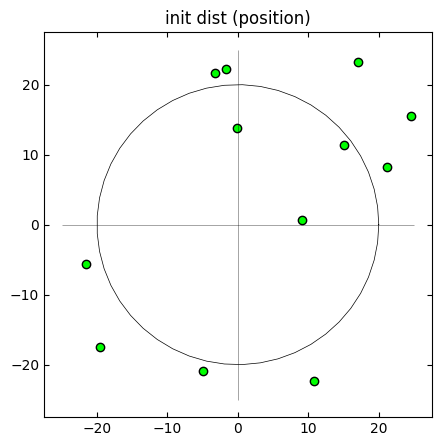

In [440]:
fig, ax=plt.subplots(figsize=(5, 5))
ax.tick_params(axis='both', which='both', direction='in', top=True, right=True)
ax.set_title('init dist (position)')
ax.hlines(0, -L-5, L+5, lw=0.5, alpha=0.5, color='k')
ax.vlines(0, -L-5, L+5, lw=0.5, alpha=0.5, color='k')
ax.plot(L*np.cos(np.linspace(0, 2*np.pi)), L*np.sin(np.linspace(0, 2*np.pi)), lw=0.5, c='k')

r=np.stack([x, y], axis=1)
ax.scatter(r[:, 0], r[:, 1], c='lime', ec='k')
plt.show()

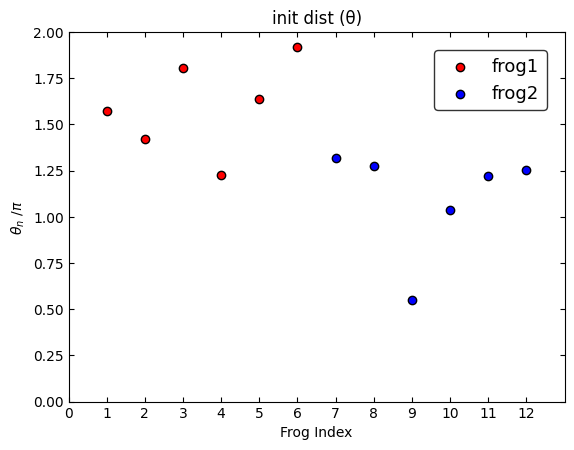

In [441]:
fig, ax = plt.subplots()
ax.tick_params(axis='both', which='both', direction='in', top=True, right=True)
ax.set_xlim(0, N+1)
ax.set_ylim(0, 2)
ax.set_xlabel("Frog Index")
ax.set_ylabel(r'$\theta_n\ /\pi$')
ax.set_xticks(np.arange(N+1))
ax.set_title('init dist (θ)')

ax.scatter(np.arange(N//2)+1, (theta1_init % 2*np.pi)/np.pi, c='r', ec='k', label='frog1')
ax.scatter(np.arange(N//2, N)+1, (theta2_init % 2*np.pi)/np.pi, c='b', ec='k', label='frog2')
ax.legend(edgecolor='k', fontsize=13, borderaxespad=1)
plt.show()

In [442]:
solution = solve_ivp(
    fun=frog_oscillator_SW,
    args=(N, L, omega, µ, c_kl, freqs, α, β),
    t_span=t_span,
    y0=state_init,
    t_eval=t_eval,
    method='RK45'
)

order parameter

In [443]:
# 周波数が同じ種間のR_{cluster}とR_{in}を計算

R_cluster_frog1, R_cluster_frog2, R_in_frog1, R_in_frog2 = [], [], [], []

for i_step_data in solution.y.T:
    θ_equ = i_step_data[:N]
    frog1_θ, frog2_θ = θ_equ[:N//2], θ_equ[N//2:]

    R_cluster_frog1.append(np.abs(np.mean(np.exp(1j * 2 * frog1_θ))))
    R_cluster_frog2.append(np.abs(np.mean(np.exp(1j * 2 * frog2_θ))))
    R_in_frog1.append(np.abs(np.mean(np.exp(1j * frog1_θ))))
    R_in_frog2.append(np.abs(np.mean(np.exp(1j * frog2_θ))))

In [444]:
# 全てのカエルのR_{cluster}とR_{in}を計算

R_cluster, R_in = [], []

for i_step_data in solution.y.T:
    θ_equ = i_step_data[:N]
    R_cluster.append(np.abs(np.mean(np.exp(1j * 2 * θ_equ))))
    R_in.append(np.abs(np.mean(np.exp(1j * θ_equ))))

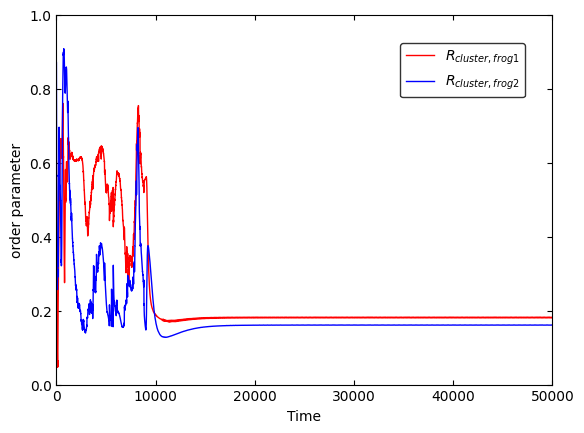

In [445]:
fig, ax = plt.subplots()

ax.set_ylim(0, 1)
ax.set_xlim(0, t_max)
ax.tick_params(axis='both', which='both', direction='in', top=True, right=True)
ax.set_xlabel("Time")
ax.set_ylabel('order parameter')

ax.plot(solution.t, R_cluster_frog1, c='r', lw=1, label=r'$R_{cluster, frog1}$')
ax.plot(solution.t, R_cluster_frog2, c='b', lw=1, label=r'$R_{cluster, frog2}$')

ax.legend(edgecolor='k', fontsize=10, borderaxespad=2)
plt.show()

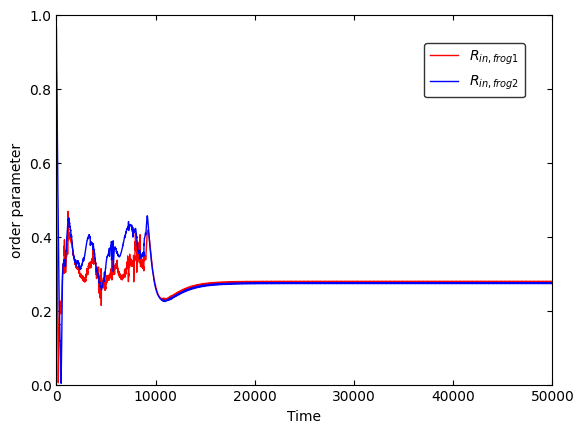

In [446]:
fig, ax = plt.subplots()

ax.set_ylim(0, 1)
ax.set_xlim(0, t_max)
ax.tick_params(axis='both', which='both', direction='in', top=True, right=True)
ax.set_xlabel("Time")
ax.set_ylabel('order parameter')

ax.plot(solution.t, R_in_frog1, c='r', lw=1, label=r'$R_{in, frog1}$')
ax.plot(solution.t, R_in_frog2, c='b', lw=1, label=r'$R_{in, frog2}$')

ax.legend(edgecolor='k', fontsize=10, borderaxespad=2)
plt.show()

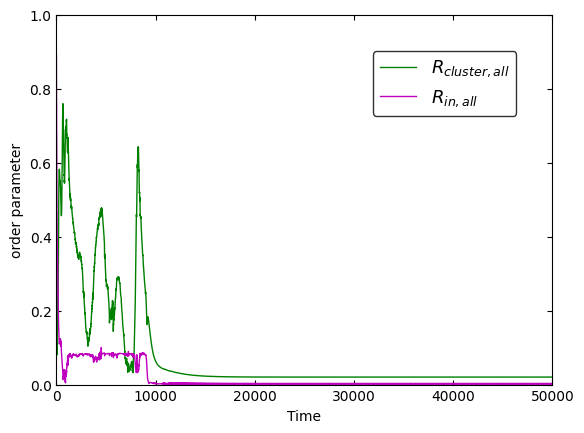

In [447]:
fig, ax = plt.subplots()

ax.set_ylim(0, 1)
ax.set_xlim(0, t_max)
ax.tick_params(axis='both', which='both', direction='in', top=True, right=True)
ax.set_xlabel("Time")
ax.set_ylabel('order parameter')

ax.plot(solution.t, R_cluster, c='g', lw=1, label=r'$R_{cluster, all}$')
ax.plot(solution.t, R_in, c='m', lw=1, label=r'$R_{in, all}$')

ax.legend(loc='upper right', edgecolor='k', fontsize=13, borderaxespad=2)
plt.show()

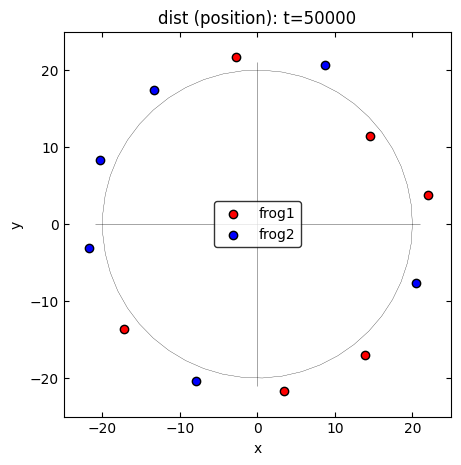

In [453]:
t = t_max
step = int(t/dt)

anystep_data = solution.y[:, step]
x_anystep = anystep_data[N:2*N]
y_anystep = anystep_data[2*N:]

fig, ax=plt.subplots(figsize=(5, 5))
ax.tick_params(axis='both', which='both', direction='in', top=True, right=True)
ax.set_xlim(-L-5, L+5)
ax.set_ylim(-L-5, L+5)
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_title(f"dist (position): t={t}")

ax.hlines(0, -L-1, L+1, lw=0.5, alpha=0.5, color='k')
ax.vlines(0, -L-1, L+1, lw=0.5, alpha=0.5, color='k')
ax.plot(L*np.cos(np.linspace(0, 2*np.pi)), L*np.sin(np.linspace(0, 2*np.pi)), lw=0.2, c='k')

ax.scatter(x_anystep[:N//2], y_anystep[:N//2], c='r', ec='k', label='frog1')
ax.scatter(x_anystep[N//2:N], y_anystep[N//2:N], c='b', ec='k', label='frog2')
ax.legend(edgecolor='k', fontsize=10, borderaxespad=2)

plt.show()

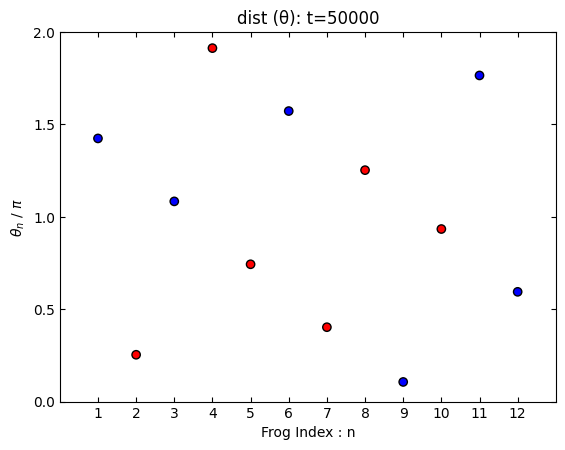

In [449]:
fig, ax = plt.subplots()

n=np.arange(N)+1

ax.set_ylim(0, 2)
ax.set_xlim(0, N+1)
ax.set_xticks(n)
ax.set_yticks(np.arange(0, 2.1, 0.5))
ax.tick_params(axis='both', which='both', direction='in', top=True, right=True)
ax.set_xlabel("Frog Index : n")
ax.set_ylabel(r"$\theta_n \ /\ \pi$")
ax.set_title(f"dist (θ): t={t}")

# 任意の時刻での位相データ
anystep_data = solution.y[:, t]
θ_anystep = anystep_data[:N]

# 空間的な角度を元に，位相をソート
angle_equ_frog = np.atan2(y_anystep, x_anystep)
sort_indices = np.argsort(angle_equ_frog)
θ_anystep_sorted = θ_anystep[sort_indices]

# 色分け
colors = np.array(['red' if i < N // 2 else 'blue' for i in range(N)])
color_sorted = colors[sort_indices]

ax.scatter(n, (θ_anystep_sorted % (2*np.pi))/np.pi, c=color_sorted, ec='k')

plt.show()

In [450]:
neighbor_log = []
for step, t in enumerate(t_eval):

    anystep_data = solution.y[:, step]
    x_anystep = anystep_data[N:2*N]
    y_anystep = anystep_data[2*N:]

    step_neighbors = np.empty((N,2), dtype=np.int32)
    for j in range(N):
        step_neighbors[j] = find_two_nearest(N, x_anystep, y_anystep, j)
    neighbor_log.append(step_neighbors)

neighbor_log[step]=array([[ 9, 10],
       [ 7,  4],
       [ 5, 11],
       [ 6,  7],
       [11,  5],
       [ 2,  8],
       [ 3,  7],
       [ 3,  1],
       [ 5,  2],
       [ 0, 10],
       [ 9,  0],
       [ 2,  4]], dtype=int32)


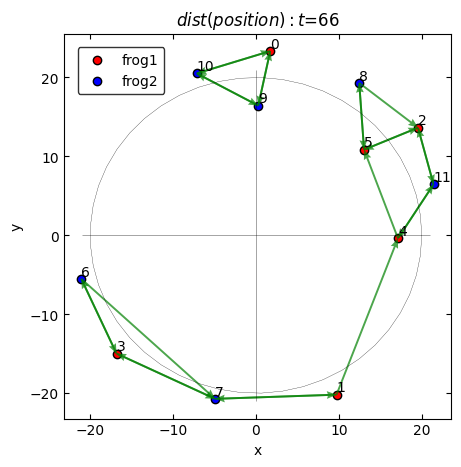

In [451]:
# t=t_max
t=66
step = int(t/dt)

anystep_data = solution.y[:, step]
x_anystep = anystep_data[N:2*N]
y_anystep = anystep_data[2*N:]

print(f'{neighbor_log[step]=}')

fig, ax=plt.subplots(figsize=(5, 5))
ax.tick_params(axis='both', which='both', direction='in', top=True, right=True)
# ax.set_xlim(-L-1, L+1)
# ax.set_ylim(-L-1, L+1)
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_title(r"$dist (position): t$"+f'={step*dt}')

ax.hlines(0, -L-1, L+1, lw=0.5, alpha=0.5, color='k')
ax.vlines(0, -L-1, L+1, lw=0.5, alpha=0.5, color='k')
ax.plot(L*np.cos(np.linspace(0, 2*np.pi)), L*np.sin(np.linspace(0, 2*np.pi)), lw=0.2, c='k')

ax.scatter(x_anystep[:N//2], y_anystep[:N//2], c='r', ec='k', label='frog1')
ax.scatter(x_anystep[N//2:N], y_anystep[N//2:N], c='b', ec='k', label='frog2')

# network
for i, neighbor in enumerate(neighbor_log[step]):
    for neighbor_i in neighbor:
        ax.quiver(x_anystep[i], y_anystep[i], (x_anystep[neighbor_i]-x_anystep[i]), (y_anystep[neighbor_i]-y_anystep[i]),
                  scale_units='xy',
                  angles='xy',
                  color='g',
                  width=0.005,
                  headwidth=4,
                  scale=1,
                  alpha=0.7)

r=np.stack([x_anystep, y_anystep], axis=1)
for i,(x,y) in enumerate(r):
    ax.annotate(str(i),(x,y), size=10, ha='left', va='bottom')

ax.legend(edgecolor='k', fontsize=10, borderaxespad=1)

plt.show()

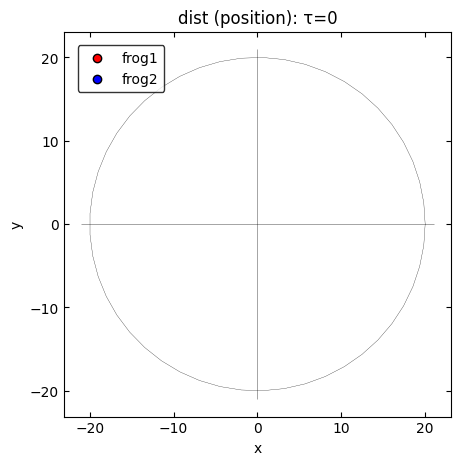

In [348]:
from matplotlib.animation import FuncAnimation

fig, ax = plt.subplots(figsize=(5, 5))
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_title("dist (position): τ=0")
ax.tick_params(axis='both', which='both', direction='in', top=True, right=True)

circle, = ax.plot([], [], 'k-', lw=0.2)
frog1 = ax.scatter([], [], c='r', ec='k', label='frog1')
frog2 = ax.scatter([], [], c='b', ec='k', label='frog2')
quivers = []

# セットアップ
ax.hlines(0, -L-1, L+1, lw=0.5, alpha=0.5, color='k')
ax.vlines(0, -L-1, L+1, lw=0.5, alpha=0.5, color='k')
ax.legend(loc='upper left', edgecolor='k', fontsize=10, borderaxespad=1)

circle.set_data(L*np.cos(np.linspace(0, 2*np.pi)),
                L*np.sin(np.linspace(0, 2*np.pi)))

def init():
    empty = np.empty((0, 2))
    frog1.set_offsets(empty)
    frog2.set_offsets(empty)
    return [frog1, frog2]

def update(frame):
    t = int(frame*dt)
    anystep_data = solution.y[:, frame]
    x_ = anystep_data[N:2*N]
    y_ = anystep_data[2*N:]

    frog1.set_offsets(np.c_[x_[:N//2], y_[:N//2]])
    frog2.set_offsets(np.c_[x_[N//2:], y_[N//2:]])

    # タイトル更新
    ax.set_title(r"$dist (position): t$"+f'={t:.2f}')

    # 既存のquiver削除
    global quivers
    for q in quivers:
        q.remove()
    quivers = []

    for i, neighbor in enumerate(neighbor_log[frame]):
        for neighbor_i in neighbor:
            dx = x_[neighbor_i] - x_[i]
            dy = y_[neighbor_i] - y_[i]
            q = ax.quiver(x_[i], y_[i], dx, dy,
                          scale_units='xy', angles='xy',
                          color='g', width=0.005,
                          headwidth=4, scale=1, alpha=0.7)
            quivers.append(q)

    return [frog1, frog2] + quivers

ani = FuncAnimation(fig, update, frames=range(0, 400, 1), init_func=init, interval=100, blit=False, repeat=False)
# ani = FuncAnimation(fig, update, frames=range(0, 4000, 10), init_func=init, interval=100, blit=False, repeat=False)


In [349]:
from IPython.display import HTML
HTML(ani.to_jshtml())

In [350]:
ani.save('network_demo.mp4')

order parameter